In [1]:
#import the dataset
import pandas as pd
dataset = pd.read_csv("TestGroup3.csv")
dataset

,PLAN_REVENUE_AMT,DISCONNECT_REASON_NAME,Disconnect Reason,GROSS_ADDS_COUNT,CPE_COUNT,WINBACK_ADD_COUNT,SERVICE_TYPE,TTL_FEAT_COUNT,FBNP_FLAG,ACTIVE_PHONE_FLAG,...,professinal_occ,sales_occ,officeadmin_occ,bluecollar_occ,farmer_occ,other_occ,retired_occ,Num_Adults_in_LU,Religious_Magazine,Occupation
0,50,0,1,0,0,0,Voice Service,12,N,A,...,1,0,0,0,0,0,0,4,0,3
1,60,0,1,1,1,1,Voice Service,4,N,A,...,0,1,0,0,0,0,0,1,0,4
2,55,0,1,1,0,0,Voice Service,6,N,A,...,0,0,0,0,0,0,0,2,0,2
3,50,0,1,1,0,0,Voice Service,11,N,A,...,1,0,0,0,0,0,0,2,0,3
4,45,0,1,0,0,0,Voice Service,15,N,A,...,0,0,0,0,0,0,1,3,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7007,50,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,0,1,0,2
7008,45,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,1,0,0,0,0,0,6,0,4
7009,35,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,0,5,0,1
7010,45,0,1,1,1,1,Voice Service,10,N,A,...,0,1,0,0,0,0,0,3,0,4


In [13]:
from pandas_profiling import ProfileReport
profile = ProfileReport(dataset, title='Cricket Wireless Data Report')
profile.to_file(output_file="cricket_wireless_data_report.html")
profile

In [14]:
data = dataset.sample(frac=0.95, random_state=786).reset_index(drop=True)
data_unseen = dataset.drop(data.index).reset_index(drop=True)

In [15]:
#import clustering module
from pycaret.clustering import *

#intialize the setup
exp_df = setup(data, normalize = True, normalize_method = 'maxabs', session_id = 123)


Setup Succesfully Completed!


,Description,Value
0,session_id,123
1,Original Data,"(6661, 147)"
2,Missing Values,False
3,Numeric Features,72
4,Categorical Features,75
5,Ordinal Features,False
6,High Cardinality Features,False
7,Transformed Data,"(6661, 571)"
8,Numeric Imputer,mean
9,Categorical Imputer,constant


In [16]:
exp_df[0]

,Disconnect_Reason,DATA_USED_1MONTH,DATA_USED_2MONTH,DATA_USED_3MONTH,DATA_USED_4MONTH,DATA_USED_5MONTH,DATA_USED_6MONTH,DATA_USED_7MONTH,DATA_USED_8MONTH,DATA_USED_9MONTH,...,Religious_Magazine_1,Occupation_1,Occupation_2,Occupation_3,Occupation_4,Occupation_5,Occupation_6,Occupation_7,Occupation_8,Occupation_9
0,0.821429,0.177001,0.316933,0.261418,0.248149,0.136653,0.114453,0.000000,0.000000,0.000000,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.714286,0.003711,0.001226,0.001261,0.000027,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0.035714,0.099776,0.143221,0.141646,0.105931,0.113452,0.114466,0.334831,0.291971,0.329713,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.142857,0.011340,0.015952,0.015820,0.012090,0.007000,0.000650,0.000000,0.000000,0.000000,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.714286,0.023694,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6656,0.714286,0.070917,0.121842,0.086781,0.029854,0.087020,0.084616,0.125334,0.149504,0.000237,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6657,0.035714,0.000434,0.000656,0.000544,0.000207,0.000341,0.000401,0.000378,0.000127,0.000000,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6658,0.714286,0.103621,0.050839,0.044159,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6659,0.714286,0.062795,0.047656,0.004440,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [17]:
kmeans = create_model('kmeans', num_clusters = 5)
print(kmeans)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=123, tol=0.0001, verbose=0)


In [18]:
results = assign_model(kmeans)
results

,PLAN_REVENUE_AMT,DISCONNECT_REASON_NAME,Disconnect_Reason,GROSS_ADDS_COUNT,CPE_COUNT,WINBACK_ADD_COUNT,SERVICE_TYPE,TTL_FEAT_COUNT,FBNP_FLAG,ACTIVE_PHONE_FLAG,...,sales_occ,officeadmin_occ,bluecollar_occ,farmer_occ,other_occ,retired_occ,Num_Adults_in_LU,Religious_Magazine,Occupation,Cluster
0,55,PORT OUT (# ported to other carrier),23,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,3,0,1,Cluster 1
1,35,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,1,0,0,0,0,0,3,0,4,Cluster 4
2,60,0,1,1,1,1,Voice Service,10,N,A,...,0,0,0,0,0,0,7,0,1,Cluster 3
3,55,BM,4,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,3,0,1,Cluster 1
4,45,NON-PAYMENT,20,1,1,1,Broadband Service,10,N,I,...,0,0,0,0,0,0,3,0,1,Cluster 1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6656,60,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,1,0,3,Cluster 0
6657,45,0,1,1,1,1,Voice Service,10,N,A,...,0,0,0,0,0,0,1,0,2,Cluster 2
6658,55,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,2,0,3,Cluster 0
6659,55,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,2,0,3,Cluster 0


In [19]:
plot_model(kmeans)

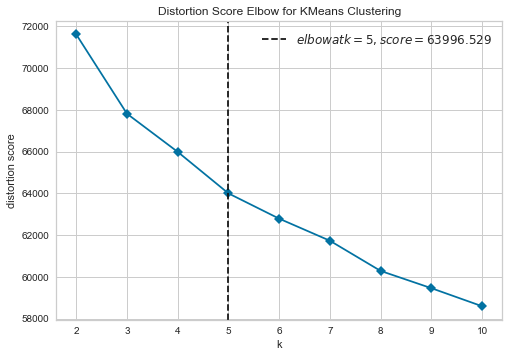

In [20]:
plot_model(kmeans, plot = 'elbow')

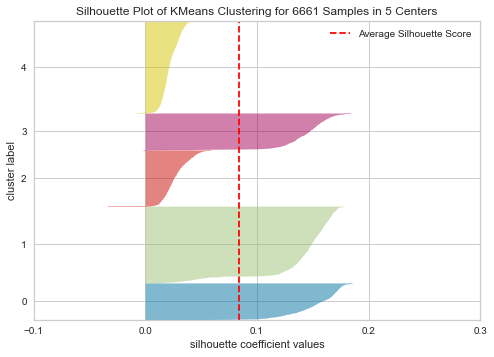

In [21]:
plot_model(kmeans, plot = 'silhouette')

In [22]:
plot_model(kmeans, plot = 'distribution') #to see size of clusters

In [23]:
unseen_predictions = predict_model(kmeans, data=data_unseen)
unseen_predictions

,PLAN_REVENUE_AMT,DISCONNECT_REASON_NAME,Disconnect_Reason,GROSS_ADDS_COUNT,CPE_COUNT,WINBACK_ADD_COUNT,SERVICE_TYPE,TTL_FEAT_COUNT,FBNP_FLAG,ACTIVE_PHONE_FLAG,...,sales_occ,officeadmin_occ,bluecollar_occ,farmer_occ,other_occ,retired_occ,Num_Adults_in_LU,Religious_Magazine,Occupation,Cluster
0,50,0,1,1,1,1,Voice Service,10,N,A,...,0,0,0,0,0,0,2,0,3,Cluster 2
1,50,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,1,0,1,Cluster 1
2,35,0,1,1,1,1,Voice Service,10,N,A,...,0,0,0,0,0,0,3,0,1,Cluster 3
3,50,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,6,0,3,Cluster 0
4,50,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,3,0,1,Cluster 1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
346,50,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,1,0,2,Cluster 4
347,45,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,1,0,0,0,0,0,6,0,4,Cluster 4
348,35,NON-PAYMENT,20,1,1,1,Voice Service,10,N,I,...,0,0,0,0,0,0,5,0,1,Cluster 1
349,45,0,1,1,1,1,Voice Service,10,N,A,...,1,0,0,0,0,0,3,0,4,Cluster 2
